# Notebook for model training

### Training Flow

Load Training Data:
- Load set of input data and label files
- Prefilter positive set only to rule out heavily-masked patches
- Create train/test set
- Define augmentation parameters

Train Model:
- Define model architecture
- Compile model
- Train and evaluate model
- Save model

In [1]:
%load_ext autoreload
%autoreload 2

In [3]:
from datetime import date
import os
import pickle
import sys

import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import classification_report
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from tensorflow import keras
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.models import Model

from keras.layers import Input, Dense, Flatten, Dropout, Conv2D
from keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tqdm.notebook import tqdm

parent_dir = os.path.split(os.getcwd())[0]
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)

from scripts import dl_utils
from scripts import viz_tools

## Open Data

In [3]:
resolution = 48

start_dates = ['2019-01-01']
end_dates = ['2020-01-01']
dates = [f'{sd}_{ed}' for sd,ed in zip(start_dates, end_dates)]

data_files = []
label_files = []
# for elem in os.listdir("C:/Users/raulp/Documents/Master/TFM/minig-detector-tfm/data/training_data/48_px"):
for elem in os.listdir("../data/training_data/48_px"):
    if "_labels.pkl" in elem:
        label_files.append(elem)
    elif ".pkl" in elem:
        data_files.append(elem)


patches = []
labels = []

data_dir = os.path.join('..', 'data', 'training_data', f"{resolution}_px")

for data, label in tqdm(zip(data_files, label_files), total=len(data_files)):
    with open(os.path.join(data_dir, data), 'rb') as f:
        data = pickle.load(f)
        for elem in data:
            #patch = dl_utils.pad_patch(elem, resolution)
            patches.append(elem)
    with open(os.path.join(data_dir, label), 'rb') as f:
        label = pickle.load(f)
        labels = np.concatenate((labels, label))

patches = np.array(patches)
positive_patches = patches[labels == 1]
negative_patches = patches[labels == 0]

print(len(patches), "samples loaded")
print(sum(labels == 1), "positive samples")
print(sum(labels == 0), "negative samples")

  0%|          | 0/15 [00:00<?, ?it/s]

2644 samples loaded
551 positive samples
2093 negative samples


  0%|          | 0/64 [00:00<?, ?it/s]

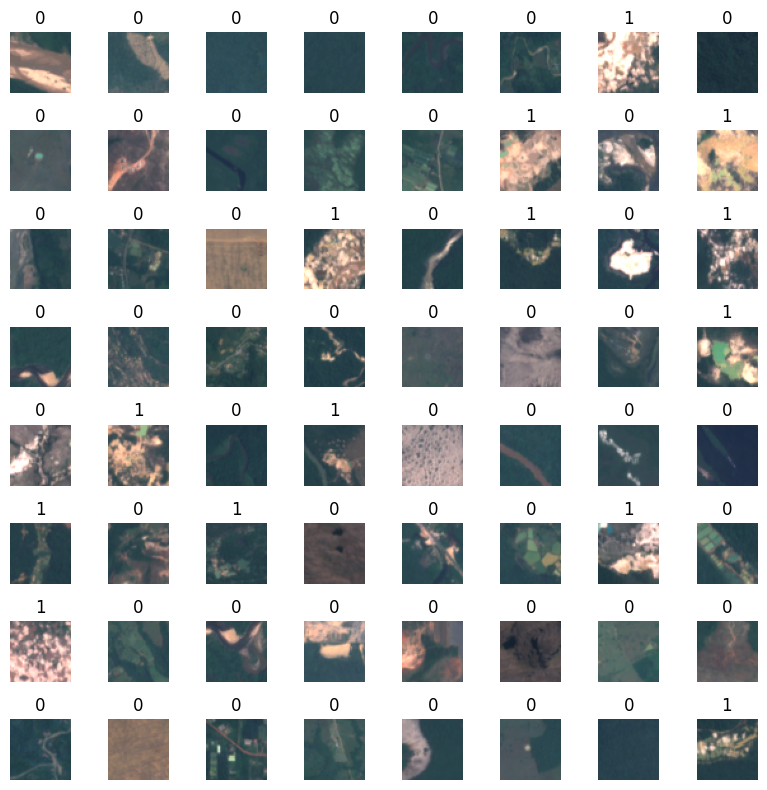

In [4]:
num_samples = 64
indices = np.random.randint(0, len(patches), num_samples)
viz_tools.plot_image_grid(patches[indices], labels=[int(label) for label in labels[indices]])

In [5]:
def filter_black(data, mask_limit=0.1, return_rejects=False):
    masked_fraction = np.array([np.sum(np.mean(patch, axis=-1) < 10) / np.size(np.mean(patch, axis=-1)) for patch in data])
    filtered_data = data[masked_fraction < mask_limit]
    print(f"{len(filtered_data) / len(data) :.1%} of data below brightness limit")
    if return_rejects:
        rejected_data = data[masked_fraction >= mask_limit]
        return filtered_data, rejected_data
    else:
        return filtered_data

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.7198333333333333].


100.0% of data below brightness limit


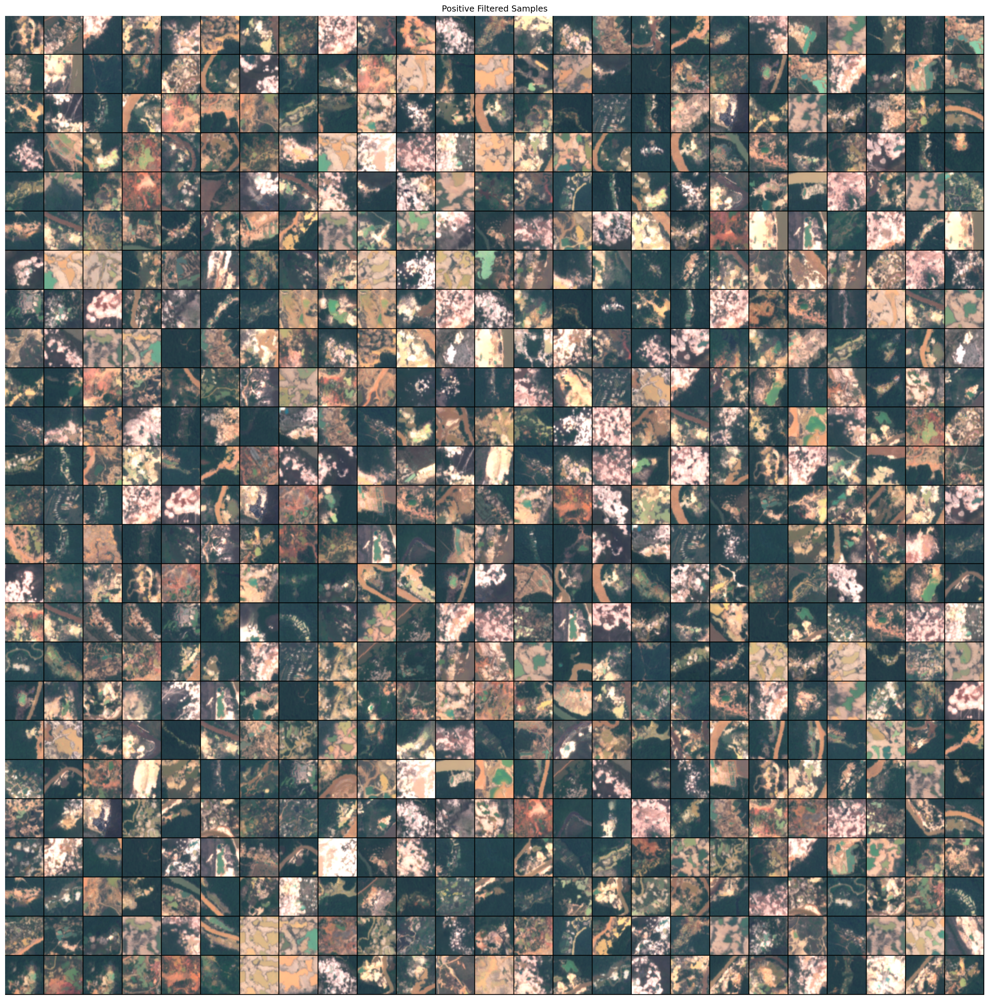

In [6]:
# Filter positive pixels that are masked beyond a threshold. Don't want to give positive examples of cloud-masked patches
filtered_positives, positive_rejects = filter_black(positive_patches, mask_limit = 0.1, return_rejects=True)
if len(positive_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(positive_rejects), num_samples)
    viz_tools.plot_numpy_grid(positive_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Positive Masked Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_positives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_positives[indices,:,:,3:0:-1] / 3000)
plt.title('Positive Filtered Samples')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..3.4073333333333333].


100.0% of data below brightness limit


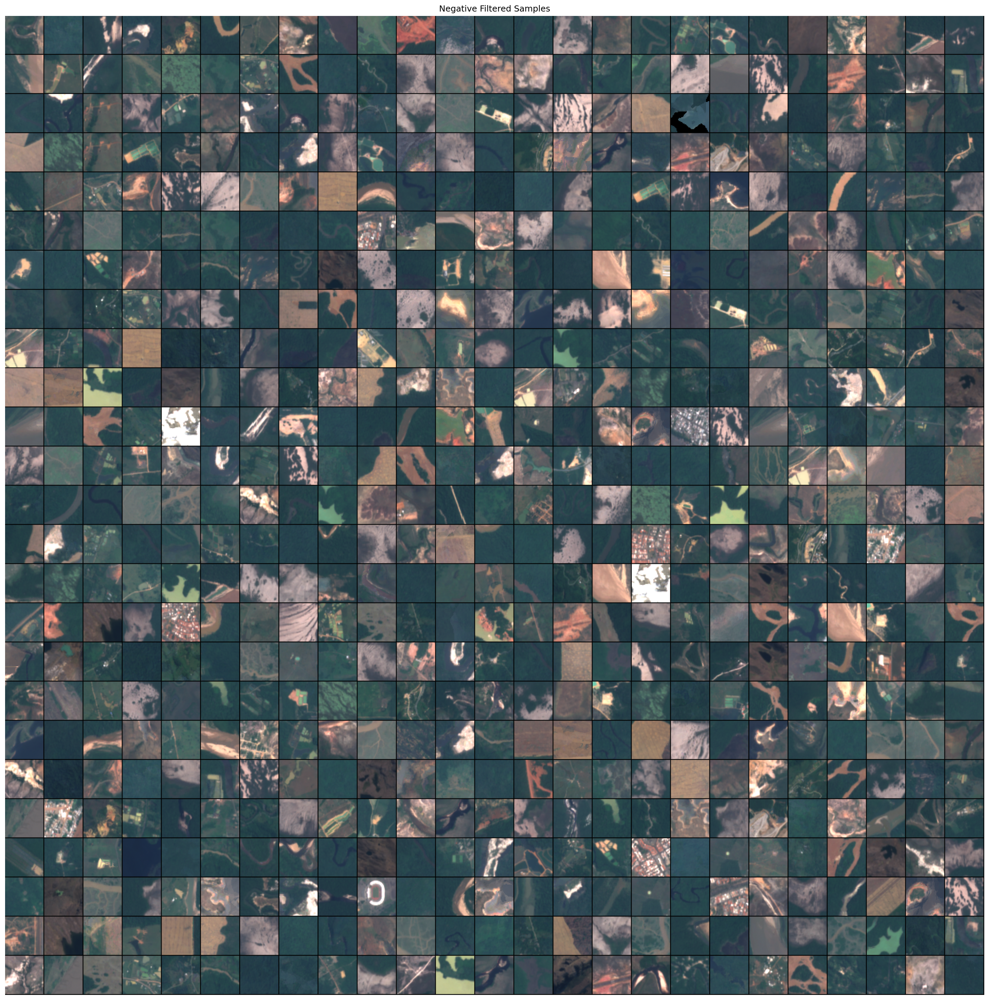

In [7]:
filtered_negatives, negative_rejects = filter_black(negative_patches, mask_limit = 0.6, return_rejects=True)
if len(negative_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(negative_rejects), num_samples)
    viz_tools.plot_numpy_grid(negative_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Negative Mask Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_negatives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_negatives[indices,:,:,3:0:-1] / 3000)
plt.title('Negative Filtered Samples')
plt.show()

## Prepare Data for Training

In [8]:
#for RGBIR, x = normalize(np.copy(images[:,:,:,[1,2,3,8]]))
x = np.concatenate((filtered_negatives, filtered_positives))
y = np.concatenate((np.zeros(len(filtered_negatives)), np.ones(len(filtered_positives))))
x, y = shuffle(x, y, random_state=33)

## Data Augmentation
Augmentation is important to help the model train. These are parameters that generally worked, but there is certainly room for improvement.

Plot a set of images to give an example of augmented images

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (2644, 48, 48, 12) (12 channels).
  warnings.warn(


  0%|          | 0/64 [00:00<?, ?it/s]

<Figure size 1800x1800 with 0 Axes>

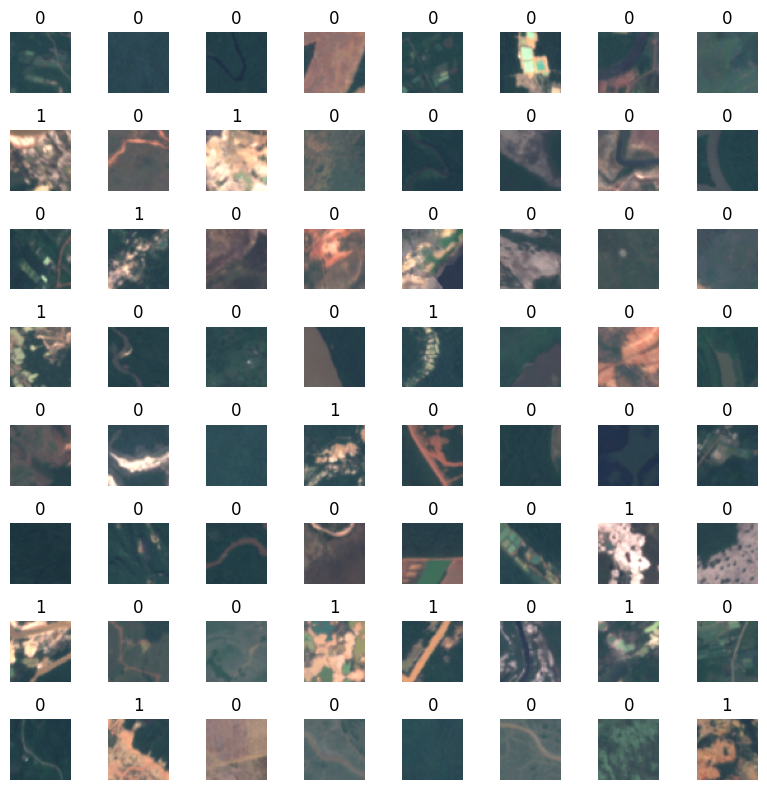

In [9]:
augmentation_parameters = {
    'featurewise_center': False,
    'rotation_range': 360,
    'width_shift_range': [0.9, 1.1],
    'height_shift_range': [0.9, 1.1],
    'shear_range': 10,
    'zoom_range': [0.9, 1.1],
    'vertical_flip': True,
    'horizontal_flip': True,
    # Fill options: "constant", "nearest", "reflect" or "wrap"
    'fill_mode': 'reflect'
}

datagen = ImageDataGenerator(**augmentation_parameters)


plt.figure(figsize=(12,12), facecolor=(1,1,1), dpi=150)
aug_img, aug_labels = datagen.flow(x, y, batch_size=64).next()
viz_tools.plot_image_grid(aug_img, labels=[int(l) for l in aug_labels], norm=True);


In [10]:
x_norm = np.clip(np.array(x.astype("float32") / 10000), 0, 1)

## Train Ensemble

In [18]:
version_number = f"3.7"
models = []
keras.utils.set_random_seed(123)
x_train, x_test, y_train, y_test = train_test_split(
    x_norm, y, test_size=0.30, random_state=123
)

num_classes = 2
input_shape = x_train.shape[1:]

# Importamos el modelo VGG16 preentrenado en ImageNet sin el top model
base_model = MobileNet(weights='imagenet',include_top=False)

# Modificamos el input ya que VGG emplea imágenes RGB
input_tensor = Input(shape=input_shape)
x = Conv2D(32, (3, 3), activation='relu', padding='same')(input_tensor)

for layer in base_model.layers[2:]:
    x = layer(x)

# Creamos un top model o clasificador
x = Flatten()(x)
x = Dense(1000, activation='relu', name='fc1')(x)
x= Dropout(0.4)(x)
x = Dense(200, activation='relu', name='fc2')(x)
x = Dense(1, activation='sigmoid', name='predictions')(x)

# Congelamos todas las capas del modelo base (la capa de input no se congela)
for layer in base_model.layers:
    if ('conv_dw' not in layer.name and 'conv_pw' not in layer.name): #or 'block5' in layer.name: #'block5_conv3' in layer.name or 'block5_conv2' in layer.name:
        layer.trainable = True
    else:
        layer.trainable = False

model = Model(inputs=input_tensor, outputs=x)

# Añadimos los pesos de las capas convolucionales de VGG16 al modelo
for i in range(2, len(model.layers)):
    if isinstance(model.layers[i], Conv2D):
        # Obtener los pesos de la capa i en el modelo original
        original_weights = base_model.layers[i].get_weights()
        # Asignar esos pesos a la capa correspondiente en el nuevo modelo
        model.layers[i].set_weights(original_weights)

model.summary()

model.compile(
    optimizer=keras.optimizers.Adam(3e-4),
    loss=keras.losses.BinaryCrossentropy(from_logits=False),
    metrics=[keras.metrics.BinaryAccuracy(name="acc")],
)


train_accuracy = []
test_accuracy = []

batch_size = 32
epochs = 160

# add a weighted loss
class_weight = {0: 1, 1: 1}

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 48, 48, 12)]      0         
                                                                 
 conv2d_1 (Conv2D)           (None, 48, 48, 32)        3488      
                                                                 
 conv1_bn (BatchNormalizati  multiple                  128       
 on)                                                             
                                                                 
 conv1_relu (ReLU)           multiple                  0         
                                                                 
 conv_dw_1 (DepthwiseConv2D  multiple                  288       
 )                                                               
                                                                 
 conv_dw_1_bn (BatchNormali  multiple                  128 

In [19]:
modelo_vgg = model.fit(
    datagen.flow(x_train, y_train),
    batch_size=batch_size,
    epochs=epochs,
    validation_data=(x_test, y_test),
    verbose=1,
    shuffle=True,
    callbacks=dl_utils.define_callbacks("model_vgg16_"),
    class_weight=class_weight,
)

current_date = date.today()
model_name = f"{resolution}px_v{version_number}_model_fine_tunning_mobile_net_{current_date.isoformat()}"

# assert not os.path.exists('../models/' + model_name + '.h5'), f"Model of name {model_name} already exists"
model.save(f"../models/{model_name}.h5")


Epoch 1/160


/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (1850, 48, 48, 12) (12 channels).
  warnings.warn(


57/58 [============================>.] - ETA: 0s - loss: 0.4163 - acc: 0.8273
Epoch 1: val_loss improved from inf to 0.40883, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_vgg16_weights.h5
58/58 [==============================] - 3s 28ms/step - loss: 0.4182 - acc: 0.8254 - val_loss: 0.4088 - val_acc: 0.8111 - lr: 3.0000e-04
Epoch 2/160
58/58 [==============================] - ETA: 0s - loss: 0.3070 - acc: 0.8789
Epoch 2: val_loss did not improve from 0.40883
58/58 [==============================] - 2s 31ms/step - loss: 0.3070 - acc: 0.8789 - val_loss: 0.4129 - val_acc: 0.8086 - lr: 3.0000e-04
Epoch 3/160
57/58 [============================>.] - ETA: 0s - loss: 0.2996 - acc: 0.8773
Epoch 3: val_loss improved from 0.40883 to 0.37210, saving model to /mnt/c/Users/raulp/Documents/Master/TFM/minig-detector-tfm/notebooks/weigths/model_vgg16_weights.h5
58/58 [==============================] - 2s 32ms/step - loss: 0.2987 - acc: 0.8773 - val_

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


# Evaluate Model Performance Characteristics

Find the threshold that maximizes performance on the test set. Note that while this may be the optimum performance on the test set, it does not account for the fact that false positives are functionally worse than false negatives.

25/25 [==============================] - 0s 3ms/step


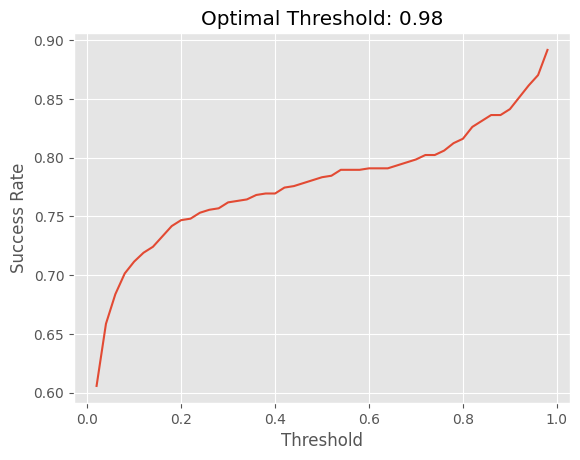

              precision    recall  f1-score   support

         0.0       0.97      0.96      0.96       629
         1.0       0.85      0.88      0.87       165

    accuracy                           0.94       794
   macro avg       0.91      0.92      0.92       794
weighted avg       0.94      0.94      0.94       794



In [20]:
test_model = model

val_images = x_test
val_labels = y_test

test_preds = test_model.predict(val_images)
thresh = []
score = []
for threshold in range(2, 100, 2):
    threshold /= 100
    thresh.append(threshold)
    test_labels = [np.argmax(y) for y in val_labels]
    test_out = [pred > threshold for pred in test_preds]
    score.append(1 - (np.sum(np.array(test_labels) != np.array(test_out)[:,0]) / len(test_labels)))
    #print(np.sum(np.array(test_labels) != np.array(test_preds)), "of", len(test_labels), "test set predictions incorrect")
plt.plot(thresh, score)
plt.ylabel('Success Rate')
plt.xlabel('Threshold')
plt.title(f"Optimal Threshold: {thresh[np.argmax(score)]:.2f}")
plt.show()
optimal_threshold = thresh[np.argmax(score)]

test_preds = np.squeeze(test_preds)
print(classification_report(val_labels, test_preds > 0.5))

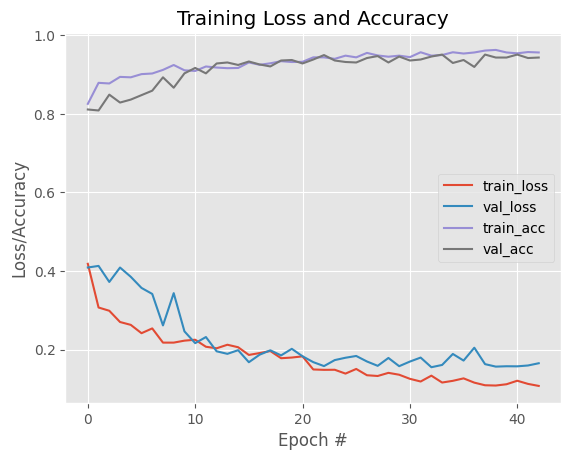

In [21]:
dl_utils.grafica_accuracy(modelo_vgg)

Plot images that the model classifies incorrectly. Can be useful to evaluate model bias.

In [ ]:
# threshold = 0.8
# test_model = model
# val_images = x_test
# val_labels = y_test
# test_labels = val_labels
# test_preds = test_model.predict(val_images)
# for index, (label, pred, img) in enumerate(zip(test_labels, test_preds, val_images)):
#     pred = pred[0]
#     if pred < threshold:
#         binary_pred = 0
#     else:
#         binary_pred = 1
#     if label != binary_pred:
#         rgb = (img[:,:,3:0:-1] * 10000 / 3000)
#         fig = plt.figure(figsize=(2,2), facecolor=(1,1,1), dpi=150)
#         plt.imshow(np.clip(rgb, 0, 1))
#         plt.title(f"label: {label} - pred: {pred:.2f}")
#         plt.axis('off')
#         plt.show()